In [1]:
import os
from itertools import count

import shapefile
import contextily as cx
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
import geopandas
import osmnx as ox
import pandas as pd
from tqdm.auto import tqdm
from libpysal.cg import voronoi_frames
import momepy
import math
import shapely
shapely.speedups.disable()

DATA = "data"

/home/asia/.pyenv/versions/3.8.0/lib/python3.8/site-packages/geopandas/_compat.py:111: UserWarning: The Shapely GEOS version (3.9.1-CAPI-1.14.2) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(


In [2]:
G = nx.read_gpickle(os.path.join(DATA, "spiw_peripheral_bike_and_investmap.gpickle"))
G=G.to_undirected()

In [3]:
for u, v, data in G.edges(data=True):
    if data["type"]=='closest_crossing':
        data["type"]='all_road'


In [4]:
buildings=[node for node in G.nodes if G.nodes[node]["type"]=="building"]

In [5]:
bike_crossings=[node for node in G.nodes if G.nodes[node]["type"]=="bike_crossing"]

In [6]:
H = nx.Graph(((u, v, e) for u,v,e in G.edges(data=True) if e['type'] == 'all_road'))

In [7]:
def path_length(G, path): 
    return sum([list(dict(G[path[i]][path[i+1]]).values())[0]['length'] for i in range(len(path)-1)])

In [8]:
for u,v,e in G.edges(data=True):
    if e['type'] == 'bike_path':
        pt1=shapely.geometry.Point(G.nodes[u]['x'],G.nodes[u]['y'] )
        pt2=shapely.geometry.Point(G.nodes[v]['x'],G.nodes[v]['y'])
        points_df = geopandas.GeoDataFrame({'geometry': [pt1, pt2]}, crs='EPSG:4326').to_crs("EPSG:2177")
        e["length"]=points_df.distance(points_df.shift())[1]
#         print(points_df.distance(points_df.shift())[1])


In [9]:
for b in buildings:
    shortest_paths=nx.shortest_path(G, source=b,  weight='length') 
    not_bike=[node for node in shortest_paths.keys() if G.nodes[node]["type"]!="bike_crossing" and G.nodes[node].get("additional")!="new_bike_path"]
    for n in not_bike:
        shortest_paths.pop(n, None)
    shortest_path=(math.inf, math.inf)
    for key, shortest_tmp in shortest_paths.items():
        shortest_length=path_length(G,shortest_tmp)
        if shortest_length<shortest_path[1]:
            shortest_path=(shortest_tmp,shortest_length)
    for i in range(len(shortest_path[0])-1):
        list(dict(G[shortest_path[0][i]][shortest_path[0][i+1]]).values())[0]['additional']="new_bike_path"
        G.nodes[shortest_path[0][i]]["additional"]="new_bike_crossing"
    G.nodes[shortest_path[0][len(shortest_path[0])-1]]["additional"]="new_bike_crossing"

In [10]:
nx.write_gpickle(G, "shortest_paths.gpickle")

In [11]:
G_nodes, G_streets = ox.graph_to_gdfs(G)

G_nodes = G_nodes.to_crs(epsg=2177)
G_streets = G_streets.to_crs(epsg=2177)

In [12]:
G_streets[G_streets['additional'] == 'new_bike_path']

osmid oneway lanes  ref  \
u          v              key                                 
146925232  3227040189     0     443826986   True     2  NaN   
           369593366      0     443761965   True     2  NaN   
149251075  1968485359     0      15109657  False   NaN  NaN   
           536_building   0           NaN    NaN   NaN  NaN   
149387980  177710771      0      14766003  False   NaN  NaN   
...                                   ...    ...   ...  ...   
9421622655 9421622658     0    1021535658  False   NaN  NaN   
9421622658 9421622664     0    1021535659  False   NaN  NaN   
9421622664 9996_building  0           NaN    NaN   NaN  NaN   
9429012468 9429012469     0    1022355208  False   NaN  NaN   
           11694_building 0           NaN    NaN   NaN  NaN   

                                              name      highway maxspeed  \
u          v              key                                              
146925232  3227040189     0          Aleja Piastów     tertiary       30   
           369593366      0          Aleja Piastów     tertiary       30   
149251075  1968485359     0    Leona Petrażyckiego  residential       30   
           536_building   0                    NaN          NaN      NaN   
149387980  177710771      0            Jana Stanki  residential       30   
...                                            ...          ...      ...   
9421622655 9421622658     0                    NaN      service      NaN   
9421622658 9421622664     0                    NaN      service      NaN   
9421622664 9996_building  0                    NaN          NaN      NaN   
9429012468 9429012469     0                    NaN      service      NaN   
           11694_building 0                    NaN          NaN      NaN   

                                   length      type  \
u          v              key                         
146925232  3227040189     0     15.973000  all_road   
           369593366      0     42.583000  all_road   
149251075  1968485359     0      6.875000  all_road   
           536_building   0     78.963290  all_road   
149387980  177710771      0    118.585000  all_road   
...                                   ...       ...   
9421622655 9421622658     0     26.331000  all_road   
9421622658 9421622664     0     17.086000  all_road   
9421622664 9996_building  0      4.489257  all_road   
9429012468 9429012469     0     38.197000  all_road   
           11694_building 0     21.649110  all_road   

                                                                        geometry  \
u          v              key                                                      
146925232  3227040189     0    LINESTRING (6428408.755 5660683.822, 6428397.0...   
           369593366      0    LINESTRING (6428451.109 5660689.365, 6428443.4...   
149251075  1968485359     0    LINESTRING (6427517.216 5660704.190, 6427517.6...   
           536_building   0    LINESTRING (6427519.334 5660710.736, 6427557.0...   
149387980  177710771      0    LINESTRING (6428059.500 5660507.272, 6428055.8...   
...                                                                          ...   
9421622655 9421622658     0    LINESTRING (6431100.468 5663914.346, 6431102.7...   
9421622658 9421622664     0    LINESTRING (6431084.546 5663911.088, 6431087.4...   
9421622664 9996_building  0    LINESTRING (6431084.546 5663911.088, 6431084.8...   
9429012468 9429012469     0    LINESTRING (6432868.048 5656881.395, 6432880.4...   
           11694_building 0    LINESTRING (6432868.048 5656881.395, 6432867.0...   

                              access     additional bridge junction   service  \
u          v              key                                                   
146925232  3227040189     0      NaN  new_bike_path    NaN      NaN       NaN   
           369593366      0      NaN  new_bike_path    NaN      NaN       NaN   
149251075  1968485359     0      NaN  new_bike_path    NaN      NaN       NaN   
           53

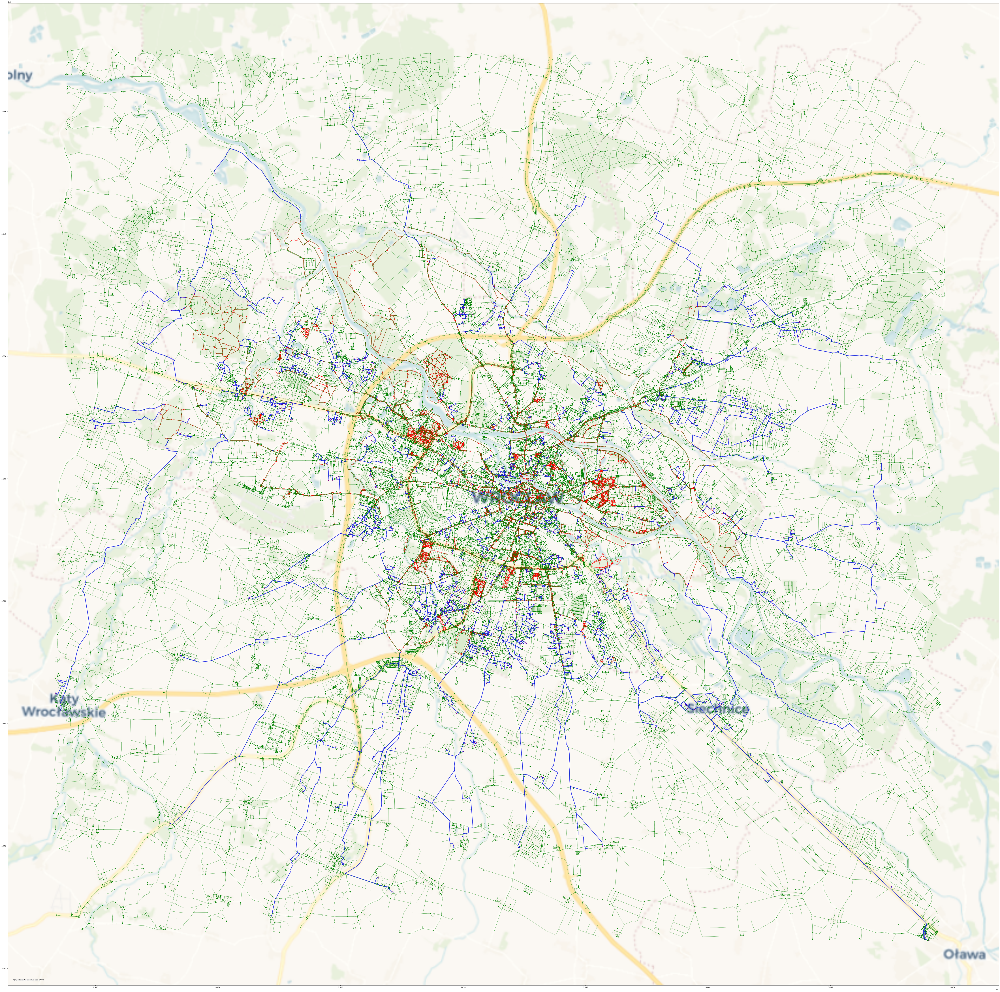

In [13]:
fig = plt.figure(figsize=(100,100))
ax = plt.subplot()

G_nodes[G_nodes['type'] == 'bike_crossing'].plot(markersize=20, color='red', ax=ax)
G_nodes[G_nodes['type'] == 'road_crossing'].plot(markersize=5, color='green', ax=ax)
G_nodes[G_nodes['type'] == 'building'].plot(markersize=20, color='purple', ax=ax)
G_streets[G_streets['type'] == 'bike_path'].plot(ax=ax, alpha=0.7, linewidth=2, edgecolor='red')
G_streets[G_streets['type'] == 'all_road'].plot(ax=ax, alpha=0.7, linewidth=1, edgecolor='green')
G_streets[G_streets.get('additional') == 'new_bike_path'].plot(ax=ax, alpha=0.7, linewidth=3, edgecolor='blue')
# G_streets.plot(ax=ax, alpha=0.7, linewidth=0.2, edgecolor='k')
cx.add_basemap(ax=ax, crs=G_nodes.crs.to_string(), source=cx.providers.CartoDB.Voyager)
plt.savefig('image/shortest_paths.jpg')